<a href="https://colab.research.google.com/github/pogiship/fuzzy-logic-application/blob/google-colab-experiment/fuzzy_project_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Fuzzy Logic for Image Quality Assessment

Install necessary dependencies.

In [1]:
import os
import zipfile
import numpy as np
import pandas as pd
# from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow import keras
from keras._tf_keras.keras.preprocessing.image import ImageDataGenerator

from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt


In [2]:
# Install necessary libraries
!pip install scikit-image scikit-fuzzy matplotlib


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 920.8/920.8 kB 11.0 MB/s eta 0:00:00


In [3]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [4]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

Saving kaggle.json to kaggle.json
User uploaded file "kaggle.json" with length 67 bytes


In [5]:
!pip install kaggle

!mkdir ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [6]:
!kaggle datasets download -d akhiljethwa/blood-cancer-image-dataset


Dataset URL: https://www.kaggle.com/datasets/akhiljethwa/blood-cancer-image-dataset
License(s): CC-BY-SA-3.0
 89% 91.0M/102M [00:00<00:00, 164MB/s]
100% 102M/102M [00:00<00:00, 140MB/s] 


In [7]:
with zipfile.ZipFile("blood-cancer-image-dataset.zip", 'r') as zip_ref:
    zip_ref.extractall("blood_cancer")


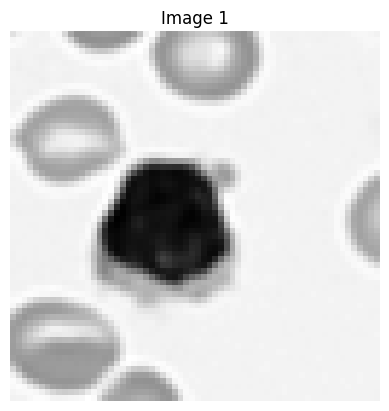

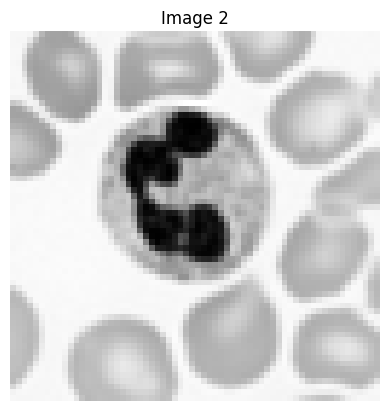

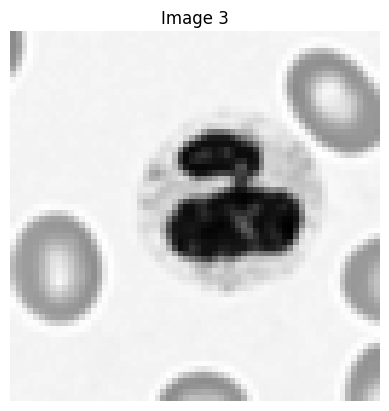

In [20]:
image_dir = "blood_cancer/Blood_Cancer"

# Load and visualize images
image_paths = [os.path.join(image_dir, fname) for fname in os.listdir(image_dir) if fname.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff'))]
images = [io.imread(path, as_gray=True) for path in image_paths]

# Display the first 3 images
for i, img in enumerate(images[:3]):
    plt.figure()
    plt.imshow(img, cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')
plt.show()


In [21]:
import numpy as np
from skimage import filters, exposure, util

# Feature extraction
def calculate_features(image):
    # Sharpness: Gradient magnitude
    gradient = filters.sobel(image)
    sharpness = np.mean(gradient)

    # Contrast: Intensity range
    contrast = image.max() - image.min()

    # Noise: Standard deviation of pixel intensity differences
    noise = np.std(util.random_noise(image) - image)

    # Brightness: Mean intensity
    brightness = np.mean(image)

    return sharpness, contrast, noise, brightness

# Calculate features for all images
features = [calculate_features(img) for img in images]
sharpness_vals, contrast_vals, noise_vals, brightness_vals = zip(*features)

print("Feature extraction complete!")


Feature extraction complete!


In [22]:
import skfuzzy as fuzz
import skfuzzy.control as ctrl

# Define fuzzy variables
sharpness = ctrl.Antecedent(np.arange(0, 1.1, 0.1), 'sharpness')
contrast = ctrl.Antecedent(np.arange(0, 1.1, 0.1), 'contrast')
noise = ctrl.Antecedent(np.arange(0, 1.1, 0.1), 'noise')
brightness = ctrl.Antecedent(np.arange(0, 1.1, 0.1), 'brightness')
quality = ctrl.Consequent(np.arange(0, 101, 10), 'quality')

# Membership functions
sharpness.automf(3)  # low, medium, high
contrast.automf(3)
noise.automf(3)
brightness.automf(3)
quality['low'] = fuzz.trimf(quality.universe, [0, 0, 50])
quality['medium'] = fuzz.trimf(quality.universe, [25, 50, 75])
quality['high'] = fuzz.trimf(quality.universe, [50, 100, 100])

# Define rules
rules = [
    ctrl.Rule(sharpness['good'] & contrast['good'] & ~noise['poor'] & brightness['average'], quality['high']),
    ctrl.Rule(sharpness['average'] | contrast['average'], quality['medium']),
    ctrl.Rule(noise['poor'] | brightness['poor'], quality['low']),
]

# Create control system
quality_ctrl = ctrl.ControlSystem(rules)
quality_sim = ctrl.ControlSystemSimulation(quality_ctrl)

print("Fuzzy logic system defined!")


Fuzzy logic system defined!


In [23]:
# Evaluate image quality
quality_scores = []
for s, c, n, b in zip(sharpness_vals, contrast_vals, noise_vals, brightness_vals):
    quality_sim.input['sharpness'] = s
    quality_sim.input['contrast'] = c
    quality_sim.input['noise'] = n
    quality_sim.input['brightness'] = b
    quality_sim.compute()
    quality_scores.append(quality_sim.output['quality'])

# Print quality scores
for i, score in enumerate(quality_scores):
    print(f"Image {i+1}: Quality Score = {score:.2f}")


Streaming output truncated to the last 5000 lines.
Image 5001: Quality Score = 25.30
Image 5002: Quality Score = 27.69
Image 5003: Quality Score = 29.33
Image 5004: Quality Score = 26.29
Image 5005: Quality Score = 28.49
Image 5006: Quality Score = 27.12
Image 5007: Quality Score = 24.23
Image 5008: Quality Score = 23.81
Image 5009: Quality Score = 24.16
Image 5010: Quality Score = 25.08
Image 5011: Quality Score = 26.60
Image 5012: Quality Score = 23.79
Image 5013: Quality Score = 27.74
Image 5014: Quality Score = 25.38
Image 5015: Quality Score = 29.78
Image 5016: Quality Score = 24.99
Image 5017: Quality Score = 25.01
Image 5018: Quality Score = 23.17
Image 5019: Quality Score = 25.38
Image 5020: Quality Score = 24.92
Image 5021: Quality Score = 24.87
Image 5022: Quality Score = 23.52
Image 5023: Quality Score = 25.38
Image 5024: Quality Score = 27.25
Image 5025: Quality Score = 25.38
Image 5026: Quality Score = 25.04
Image 5027: Quality Score = 23.53
Image 5028: Quality Score = 27.

<ipython-input-24-f3a3845ed85a>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


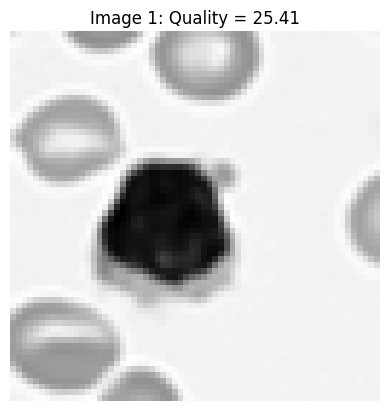

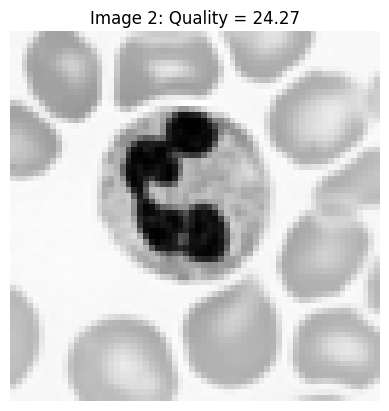

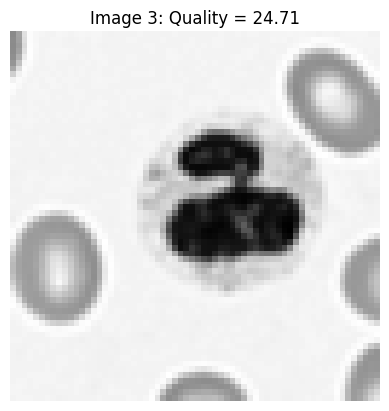

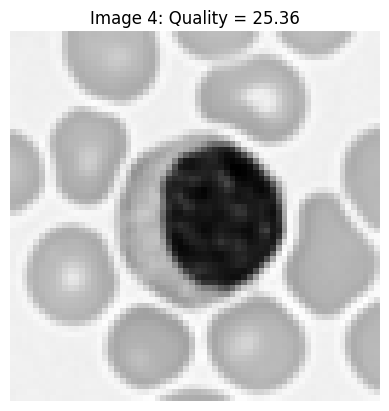

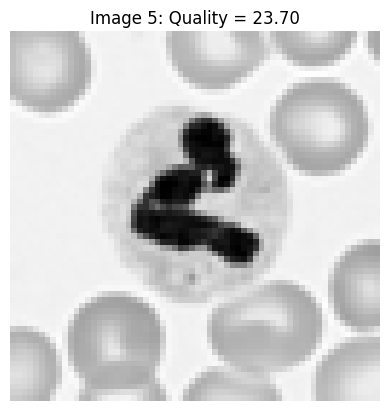

...

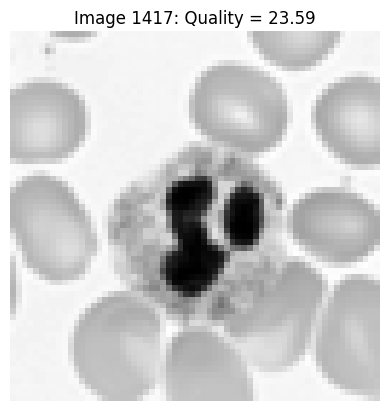

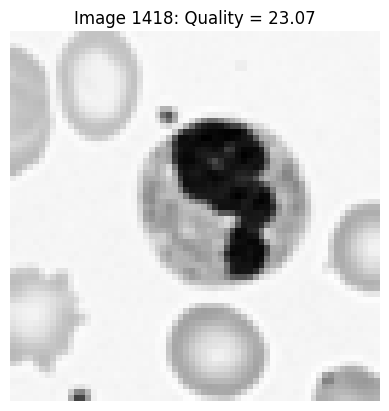

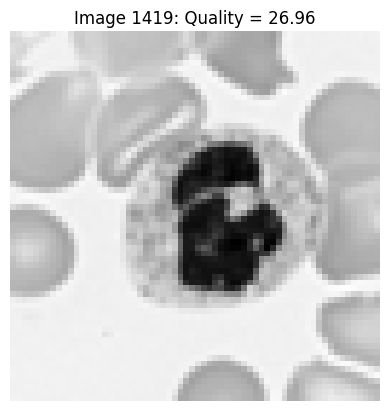

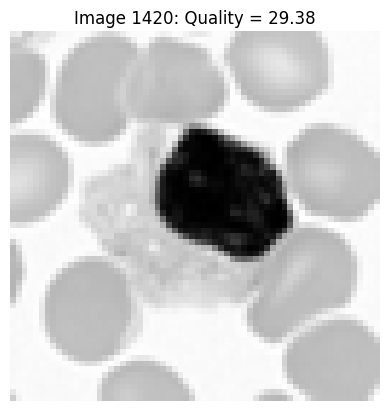

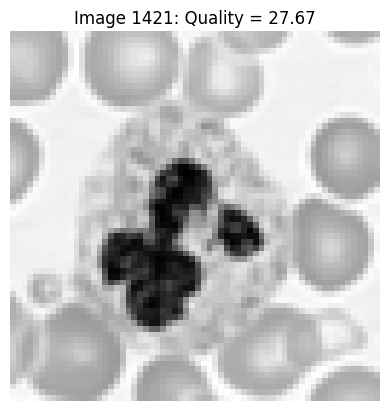

KeyboardInterrupt: 

In [24]:
for i, (img, score) in enumerate(zip(images, quality_scores)):
    plt.figure()
    plt.imshow(img, cmap='gray')
    plt.title(f"Image {i+1}: Quality = {score:.2f}")
    plt.axis('off')
plt.show()


In [26]:
# Categorize scores based on thresholds
high_quality = [score for score in quality_scores if score > 25]
medium_quality = [score for score in quality_scores if 20 <= score <= 25]
low_quality = [score for score in quality_scores if score < 20]

# Count images in each category
num_high = len(high_quality)
num_medium = len(medium_quality)
num_low = len(low_quality)

# Print results
print(f"Number of High Quality Images: {num_high}")
print(f"Number of Medium Quality Images: {num_medium}")
print(f"Number of Low Quality Images: {num_low}")


Number of High Quality Images: 3915
Number of Medium Quality Images: 6085
Number of Low Quality Images: 0


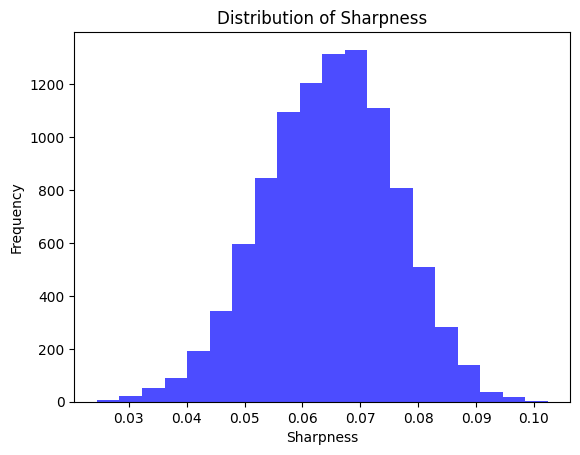

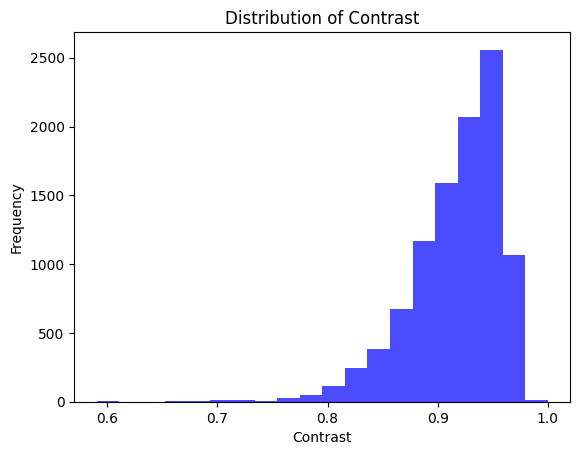

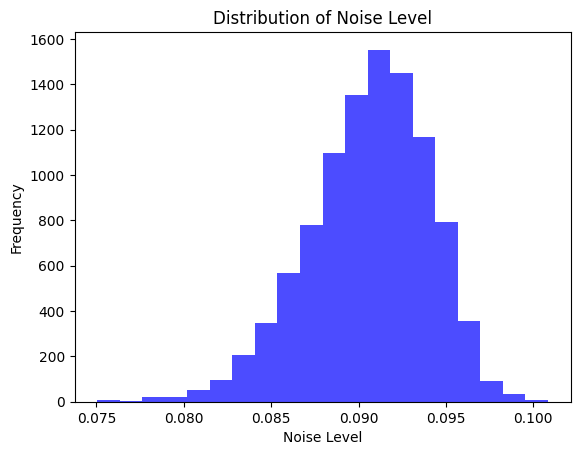

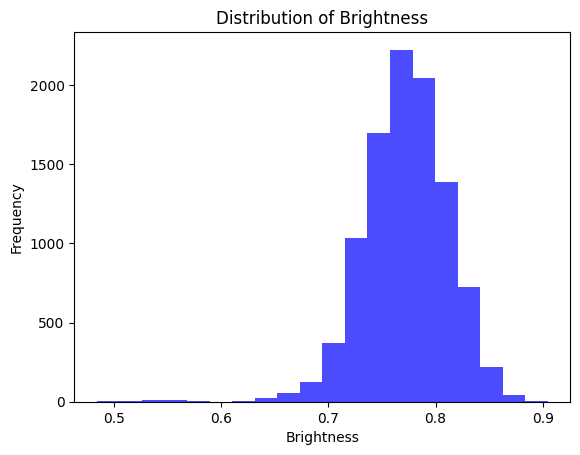

In [28]:
import matplotlib.pyplot as plt

metrics = ['Sharpness', 'Contrast', 'Noise Level', 'Brightness']
data = [sharpness_vals, contrast_vals, noise_vals, brightness_vals]

for i, metric in enumerate(metrics):
    plt.figure()
    plt.hist(data[i], bins=20, alpha=0.7, color='blue')
    plt.title(f'Distribution of {metric}')
    plt.xlabel(metric)
    plt.ylabel('Frequency')
    plt.show()


In [ ]:
# Import visualization library
import matplotlib.pyplot as plt

# Define labels and sizes
labels = ['High Quality', 'Medium Quality', 'Low Quality']
sizes = [num_high, num_medium, num_low]
colors = ['#66b3ff', '#ffcc99', '#ff6666']  # Customize colors

# Create pie chart
plt.figure(figsize=(6, 6))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', colors=colors, startangle=140)
plt.title("Quality Distribution of Images")
plt.axis('equal')  # Equal aspect ratio ensures the pie is a circle.
plt.show()
